0    labels/FDDB-fold-05-ellipseList.txt
1    labels/FDDB-fold-02-ellipseList.txt
2    labels/FDDB-fold-03-ellipseList.txt
3    labels/FDDB-fold-04-ellipseList.txt
4    labels/FDDB-fold-01-ellipseList.txt
5    labels/FDDB-fold-06-ellipseList.txt
6    labels/FDDB-fold-09-ellipseList.txt
7    labels/FDDB-fold-10-ellipseList.txt
8    labels/FDDB-fold-07-ellipseList.txt
9    labels/FDDB-fold-08-ellipseList.txt
dtype: object


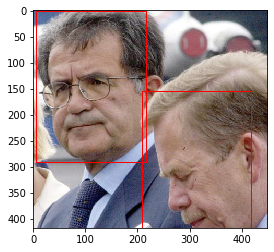

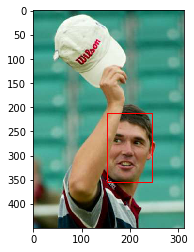

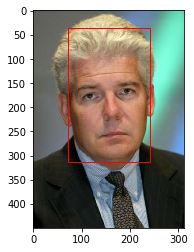

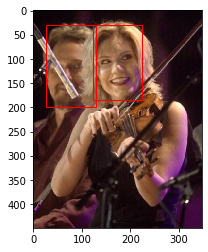

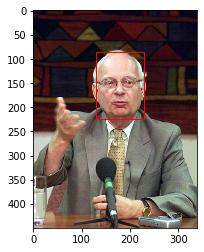

...

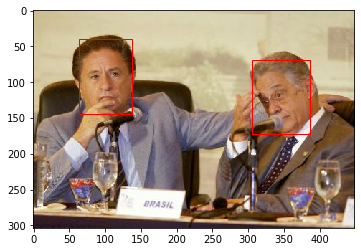

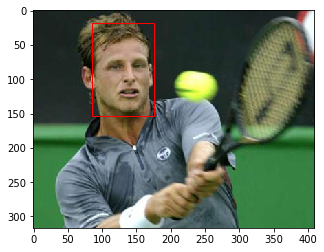

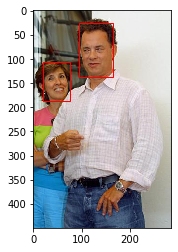

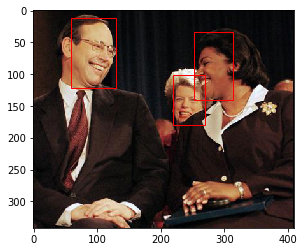

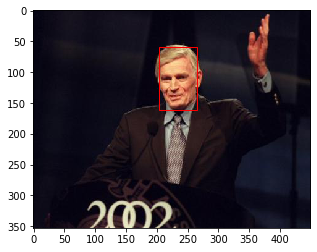

2002_07_31_big_img_249.jpg not found...


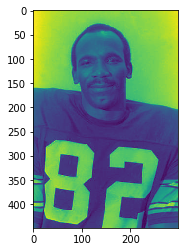

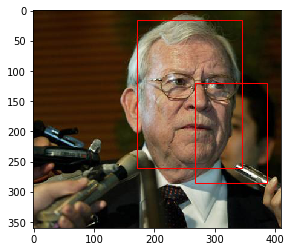

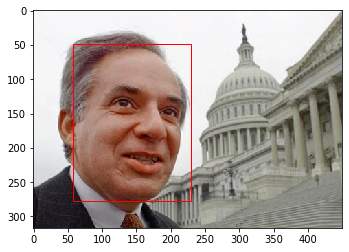

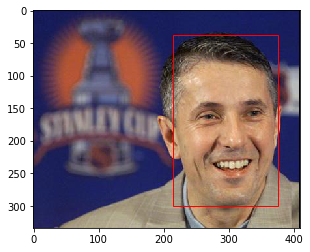

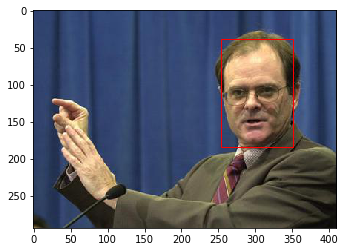

...

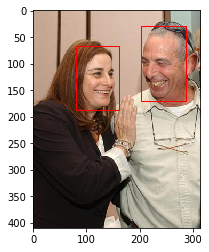

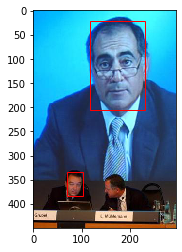

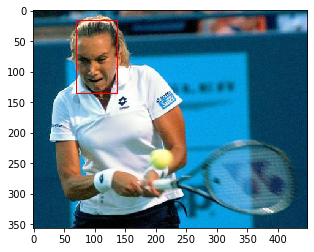

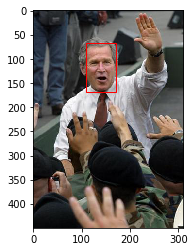

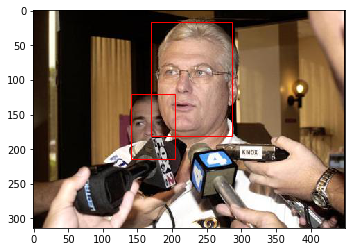

0      {'nombre': '2002_08_16_big_img_932.jpg', 'anno...
1      {'nombre': '2002_07_19_big_img_393.jpg', 'anno...
2      {'nombre': '2002_08_20_big_img_764.jpg', 'anno...
3      {'nombre': '2002_08_15_big_img_616.jpg', 'anno...
4      {'nombre': '2002_07_26_big_img_267.jpg', 'anno...
                             ...                        
292    {'nombre': '2003_01_15_big_img_475.jpg', 'anno...
293    {'nombre': '2002_08_14_big_img_620.jpg', 'anno...
294    {'nombre': '2002_08_21_big_img_167.jpg', 'anno...
295    {'nombre': '2002_07_19_big_img_300.jpg', 'anno...
296    {'nombre': '2002_07_26_big_img_219.jpg', 'anno...
Length: 297, dtype: object


In [36]:
import glob
import math
from pathlib import Path
import pandas as pd
import re
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as patches
import numpy as np
import os


def transformCoordinates(coordinates, wmax, hmax):
    datos=coordinates.split()
    a=float(datos[0])
    b=float(datos[1])
    ang=float(datos[2])
    x=float(datos[3])
    y=float(datos[4])
    width = 2*(math.sqrt(a*a*math.cos(ang)**2+b*b*math.sin(ang)**2))
    height = 2*(math.sqrt(a*a*math.sin(ang)*math.sin(ang)+b*b*math.cos(ang)*math.cos(ang)))
    esquinaIzqX = x-width/2
    esquinaIzqY = y-height/2
    if esquinaIzqX<0:
        esquinaIzqX=0
    if esquinaIzqY<0:
        esquinaIzqY=0
    if esquinaIzqX>wmax:
        esquinaIzqX=wmax
    if esquinaIzqY>hmax:
        esquinaIzqY=hmax
    

    return (round(esquinaIzqX),round(esquinaIzqY),round(width),round(height))

def returnEllipseListFiles(path):
    return [str(f) for f in Path(path).glob("**/*-ellipseList.txt")]

def generateArray(file):
    with open(files[file], "r") as f:
        array = f.read().splitlines()
    i=0
    diccionarios = []
    rg = re.compile("(\d)*_(\d)*_(\d)*_big")
    
    while (i<len(array)):
        renglon = array[i]
        if  rg.match(renglon):
            try:
                #Cuantas caras hay en imagem
                cantCaras = int(array[i+1])
                #Formato de lectura
                key = "{}.jpg".format(renglon)
                img = mpimg.imread(os.path.join("dataset",key)) 
                fig,ax = plt.subplots(1)
                ax.imshow(img)
                (h,w, _) = img.shape
                
                rectangulos = []
                for x in range(cantCaras):
                    #annotations.append(array[i+x+2]) este se ocupaba para elipses
                    #Armar rectangulos
                    rec =transformCoordinates(array[i+x+2], w, h)
                    rectangulos.append(rec)
                    rect = patches.Rectangle(
                        (rec[0],rec[1]),rec[2],rec[3],
                        linewidth=1,
                        edgecolor='r',
                        facecolor='none')
                    ax.add_patch(rect)
                plt.show()
                    
                thisDict=dict()
                thisDict={"nombre": key, "annotations": rectangulos,"size":{"width": w, "height": h}}
                
                
                
                
                diccionarios.append(thisDict)
                i=i+cantCaras+2
            except:
                print("{} not found...".format(key))
                i=i+1
        else:
            i=i+1
            
    diccionarios=pd.Series(diccionarios)

    return diccionarios
    


#files = glob.glob("/Users/Marcos/Downloads/SextoSemestre/Softek/dirty_dataset/labels/*-ellipseList.txt")

files = returnEllipseListFiles("labels")
files = pd.Series(files)
print(files)


folder = glob.glob("/Users/Marcos/Downloads/SextoSemestre/Softek/dirty_dataset/dataset/*.jpg")
folder = pd.Series(folder)

labels = glob.glob("/Users/Marcos/Downloads/SextoSemestre/Softek/dirty_dataset/labels/*.jpg")
folder = pd.Series(folder)

array = generateArray(0)

print (array)


img = mpimg.imread(os.path.join("dataset",'2002_08_16_big_img_932.jpg')) 
(h,w, _) = img.shape



#transformCoordinates("10.0 15.0 1 10.866267 282.220968  1", w, h)
        
    



In [ ]:
import glob
import math
from pathlib import Path
import pandas as pd
import re
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as patches
import numpy as np
import os


def transformCordinates(coordinates, wmax, hmax):

    return ()

def generateArray(file):
    with open(file, "r") as f:
        arr = f.read().splitlines()
    
    arr_len = len(arr)
    i = 0    
    # regex
    rg = re.compile("(\d)*_(\d)*_(\d)*_big")
    output = []
    while i != arr_len:
        val = arr[i] # nombre de la imagen
        mtch = rg.match(val)
        if mtch:
            try:
                di = dict() #diccionario
                val = "{}.jpg".format(val)
                di["name"] = val
                #  matplotlib
                img = mpimg.imread(os.path.join("dataset", val))
                (h, w, _) = img.shape

                jumps = int(arr[i+1])
                temp = []
                for j in range(0, jumps):
                    coords = arr[i + j +2]
                    temp.append(coords)
                    # transformCordinates(string, w, h)
                di["annotations"] = temp
            except:
                print("{} not found...".format(val))
                i+=1
              
        else:
            i+=1




def returnEllipseListFiles(path):
    return [str(f) for f in Path(path).glob('**/*-ellipseList.txt')]

folder = glob.glob("dataset/*.jpg")
folder = pd.Series(folder)
files = returnEllipseListFiles("labels")